## Базовая часть:

### 1. Предобработка текстов из датасета

In [1]:
DATA_PATH = "D:\\DS\\NLP_Final_Project\\data"

In [2]:
import numpy as np
import json

# загружаем предобработанный датасет MSCOCO (векторы изображений и соответствующие описания)
img_codes = np.load(DATA_PATH + "\\image_codes.npy")
captions = json.load(open(DATA_PATH + '\\captions_tokenized.json'))

В датасете все captions(тексты-описания) уже токенизированы и приведены в нижний регистр. Теперь нужно сделать следующее:

1. Добавить ко всем описаниям символы начала и конца предложения 
2. Посчитать частоту встречания каждого слова из словаря и оставить тольео те, которые встречаются больше Х раз (например, Х=5)
3. Создать словарь из оставшихся слов + символов начала, конца предложения и PAD символа
4. Написать функцию, которая будет возвращать батч из описаний (к каждой картинке при создании батча рандомно выбирать одно из ее описаний). 
5. Поделить выборку на train/test
         
То есть, короткие предложения дополняются PAD символами, слишком длинные обрезаются. В начале и конце предложения вставлены коды символов начала и конца предложения.

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import nltk
import torchtext
import random
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt
%matplotlib inline
import plotly.express as px
from PIL import Image
import warnings
warnings.filterwarnings("ignore")

import modules
from modules.vocabulary import Vocabulary
from modules.dataset import CocoDataset
from modules.dataloader import CocoDataloader
from modules.models import CaptionNet, CaptionNetWithAttantion2LSTM
from modules.generate_captions import GenerateCaptions

SEED = 1234
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

### Создание LSTM-сети для вывода описаний


In [15]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

embed_size = 256
hidden_size = 256
vocab_size = len(dataset.vocab)
num_layers = 1
learning_rate = 3e-4

# CaptionNet - класс для построения модели на основе LSTM, которая генерирует описания изображений.
model = CaptionNet(embed_size, hidden_size, vocab_size, num_layers).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.vocab.stoi["<pad>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate) # favourite one

In [16]:
model

CaptionNet(
  (img_embed): Linear(in_features=2048, out_features=256, bias=True)
  (embed): Embedding(12760, 256)
  (lstm1): LSTM(256, 256, batch_first=True)
  (linear): Linear(in_features=256, out_features=12760, bias=True)
)

### Обучение модели на MS COCO датасете вместе с Flickr Image dataset (30 000 изображений)

План:

1. Предобработать Flickr Image dataset, чтобы получить векторы изображений и их описания в том же формате, что и имеющийся MS COCO:

    а) описания изображений, хранящиеся в results.csv, преобразовать в список, аналогичный captions: [[описания первого изображения], [описания второго изображения], ... [описания последнего изображения] ].
    
    б) получить векторы изображений используя ту же предобученную inception_v3.
    
    
2. Объединить векторы изображений и их описания из MS COCO и Flickr в общий датасет и на нем обучить модель. 

In [4]:
# Адрес папки с файлами Flickr-датасета
DATA_PATH_FLICKR = 'D:\\DS\\NLP_Final_Project\\flickr30k_images\\'

In [5]:
import pandas as pd
# Читаем файл с описаниями для Flickr-датасета. 
# Здесь, как и в Coco-датасете, на одно изображение приходится около 5 описаний.
df = pd.read_csv(DATA_PATH_FLICKR + 'results.csv', sep='|')
df.head()

,image_name,comment_number,comment
0,1000092795.jpg,0,Two young guys with shaggy hair look at their...
1,1000092795.jpg,1,"Two young , White males are outside near many..."
2,1000092795.jpg,2,Two men in green shirts are standing in a yard .
3,1000092795.jpg,3,A man in a blue shirt standing in a garden .
4,1000092795.jpg,4,Two friends enjoy time spent together .


In [6]:
# Выявляем индексы строк, в которых нет описания(' comment') т.е. стоит NaN. 
comment_is_nan_indexes = df[' comment'][df[' comment'].isna()].index
# Таких строк всего одна, удалим её. 
df.drop(index=comment_is_nan_indexes, inplace=True) 

In [7]:
# Приведем описания к нижнему регистру, удалим запятые.
df[' comment'] = df[' comment'].str.lower().str.replace(',', '')

In [8]:
# Построим словарь вида: ['имя файла с изображением'] = [список описаний данного изображения]
flickr_captions_dictionary = df.groupby('image_name')[' comment'].apply(list).to_dict()
flickr_captions_dictionary['1000092795.jpg']

[' two young guys with shaggy hair look at their hands while hanging out in the yard .',
 ' two young  white males are outside near many bushes .',
 ' two men in green shirts are standing in a yard .',
 ' a man in a blue shirt standing in a garden .',
 ' two friends enjoy time spent together .']

In [9]:
# Построим список вида: [[список описаний 0-го изображения], [список описаний 1-го изображения]...]
flickr_captions_list = df.groupby('image_name')[' comment'].apply(list).to_list()
flickr_captions_list[0]

[' two young guys with shaggy hair look at their hands while hanging out in the yard .',
 ' two young  white males are outside near many bushes .',
 ' two men in green shirts are standing in a yard .',
 ' a man in a blue shirt standing in a garden .',
 ' two friends enjoy time spent together .']

In [10]:
import json 
# Загрузим описания для COCO-датасета
coco_captions_list = json.load(open(DATA_PATH + '\\captions_tokenized.json'))
# Объединим их с описаниями для flickr в один общий список 
all_captions = coco_captions_list + flickr_captions_list
# Всего получилось 150070 описаний (запомним это число - у нас должно получиться столько же векторов изображений)
len(all_captions)

150070

In [11]:
# Создадим словарь на основе общего списка описаний 
tokenizer = nltk.WordPunctTokenizer()
voc = Vocabulary(tokenizer, 5)
voc.build_vocabulary(all_captions)
voc

Для определения оптимальной длины предложения, под которую будем подгонять каждое предложение, построим boxplot. Он покажет, вокруг каких значений сосредоточены наиболее часто встречающиеся длины предложений в датасете.

In [24]:
# Для построения boxplot раскомментируйте и запустите код. 
# Здесь боксплот не отображен т.к. из-за его "веса" ноутбук не проходит по максимальному размеру GitHub (25 Мб).  
# fig = px.box(voc.all_lenght_captions)
# fig.show()

Согласно полученному boxplot медианная длина описания изображения равна 11.

50% длин описаний изображений находится в интервале от 10 до 13 токенов. Еще 25% длин лежит в интервале от 2(минимальная длина описания) до 10(граница первого квартиля). Из оставшихся 25% длин большая часть не превышает 17("upper fence" boxplot-а).

Таким образом, представляется логичным использовать в качестве длины предложения 17 + 2 = 19 токенов, где добавленные 2 - это токены начала и конца предложения. Более короткие предложения будем дополнять паддингами до 19, более длинные - укорачивать.

Теперь перейдем к обработке изображений. Для coco-датасета уже есть векторы изображений, для flickr еще только предстоит их получить.

In [25]:
# Адрес папки с изображениями из flickr
imgs_folder = DATA_PATH_FLICKR + 'flickr30k_images\\'
# Строим список с адресами всех изображений и сразу проверяем, что описания идут в том же порядке, что и изображения, 
# чтобы потом, при формировании датасета, не было путаницы.
images_paths = []
for f, caption in zip(listdir(imgs_folder), flickr_captions_dictionary):
    if (isfile(join(imgs_folder, f))) & (f.endswith(('jpg', 'png'))):
        images_paths.append(imgs_folder + f)
    if f != caption:
        print('f =', f, 'caption =', caption)
images_paths[0]

'D:\\DS\\NLP_Final_Project\\flickr30k_images\\flickr30k_images\\1000092795.jpg'

In [26]:
# Всего изображений в flickr-датасете
len(images_paths)

31783

In [27]:
# Для предобработки изображений и получения из них векторов потребуется функция img_to_vectors класса GenerateCaptions. 
# Создадим объект этого класса. Для экономии памяти параметры model2 и vocab_itos инициализируем 0 и пустой строкой, они при
# предобработке изображений не понадобятся.
model2 = 0
vocab_itos = ''
process_imgs = GenerateCaptions(model2, vocab_itos, True)
process_imgs

In [ ]:
import numpy as np
# В список l будем записывать полученные после обработки изображений предобученной inception_v3 тензоры. 
# Каждые 500 изображений будем объединять тензоры в один и сохранять в новый файл, а список l - обнулять. Это нужно для 
# очистки памяти т.к. мой ноутбук не позволяет обработать все изображения за раз. 
l = []
for i, path in enumerate(images_paths):
    img = Image.open(path)
    img = img.resize((299, 299))
    img_vectors = process_imgs.img_to_vectors(img)
    l.append(img_vectors)
    if i % 500 == 0:
        torch.save(torch.stack(l).squeeze(1), DATA_PATH_FLICKR + str(i - 500) +' - ' + str(i) + '_flickr_img_vectors.pt') 
        l = []

In [21]:
# Последний список l также сохраняем (он не обнулился и не сохранился в цикле т.к. число элементов в нём не кратно 500).
torch.save(torch.stack(l).squeeze(1), DATA_PATH_FLICKR + str(31500) + '-end_flickr_img_vectors.pt') 
l = []

In [78]:
# Теперь нужно получить список адресов тех 65-ти файлов, которые мы создали. Обычный listdir(DATA_PATH_FLICKR) тут не подойдет
# т.к. сортировка файлов в нем идет в алфавитном, а не в человеческом порядке (названия файлов содержат числа).
# Отсортируем список так, как нам нужно
import re

def atoi(text):
    return int(text) if text.isdigit() else text

def natural_keys(text):
    return [atoi(c) for c in re.split(r'(\d+)', text)]

alist = listdir(DATA_PATH_FLICKR)

alist.sort(key=natural_keys)
alist.insert(0, alist[-3])
alist = alist[:-3]

In [95]:
# Получили список правильно отсортированных названий файлов
alist[:10]

['-500 - 0_flickr_img_vectors.pt',
 '0 - 500_flickr_img_vectors.pt',
 '500 - 1000_flickr_img_vectors.pt',
 '1000 - 1500_flickr_img_vectors.pt',
 '1500 - 2000_flickr_img_vectors.pt',
 '2000 - 2500_flickr_img_vectors.pt',
 '2500 - 3000_flickr_img_vectors.pt',
 '3000 - 3500_flickr_img_vectors.pt',
 '3500 - 4000_flickr_img_vectors.pt',
 '4000 - 4500_flickr_img_vectors.pt']

In [81]:
# Объединим векторы изображений coco и flickr датасетов в один общий np-массив
all_img_vectors = img_codes.copy()
for f in alist:
    if (isfile(join(DATA_PATH_FLICKR, f))) & (f.endswith(('pt'))):
        set_of_img_vectors = torch.load(DATA_PATH_FLICKR + f).detach().numpy()
        all_img_vectors = np.concatenate([all_img_vectors, set_of_img_vectors])
# Увидим, что их ровно столько же сколько и полученных выше наборов описаний
len(all_img_vectors)

150070

In [82]:
all_img_vectors.shape

(150070, 2048)

In [84]:
# Сохраним полученные векторы в npy файл, чтобы в будущем сразу получать их оттуда и не повторять проделанные выше действия
# from numpy import save
# save(DATA_PATH_FLICKR + 'coco_plus_flickr.npy', all_img_vectors)

In [12]:
all_img_vectors = np.load(DATA_PATH_FLICKR + 'coco_plus_flickr.npy')

# Создадим экземпляр датасета (на данных из обоих датасетов) 
dataset = CocoDataset(all_img_vectors, all_captions, 5, 17)

# Размер представления случайного изображения
dataset[10][0].shape

torch.Size([2048])

In [13]:
len(dataset.vocab)

12760

In [14]:
# Создаем загрузчики данных (dataloaders) на данных из обоих датасетов
freq_treshold = 5
max_len_caption = 17
dataloader_obj = CocoDataloader(all_img_vectors, all_captions, freq_treshold, max_len_caption)
train_loader, valid_loader = dataloader_obj.get_dataloaders()

Количество экземпляров в тренировочном датасете: 135063
Количество экземпляров в валидационном датасете: 15007


Побробуем обучить простую модель (без attention) на этих двух датасетах.

In [20]:
from tqdm.notebook import tqdm

num_epochs = 10
cur_patience = 0
patience = 3
best_valid_loss = 1000000

# Train loop
for e in range(num_epochs):
    model.train()
    train_loss = 0
    for batch in tqdm(train_loader):
        images, captions = (batch['images'].to(device), 
                                batch['captions'].to(device))
        # 1. Получаем логиты, прогоняя image_vectors через сеть
        logits = model(images, captions)   
         
        # 2. Вычисляем лосс-функцию между полученными логитами и captions_ix.
        # logits.reshape(-1, logits.shape[2]) = torch.Size([544, 10312]) = [batch_size * sen_len, vocab_size]
        # captions.reshape(-1) =  torch.Size([544]) = [batch_size * sen_len]
        loss = criterion(logits.reshape(-1, logits.shape[2]), captions.reshape(-1)) 
        train_loss += loss.item()
        loss.backward()

        optimizer.step()
        optimizer.zero_grad()
        
    valid_loss = 0
    model.eval()
    with torch.no_grad():
        for batch in valid_loader:            
            images, captions = (batch['images'].to(device), 
                                batch['captions'].to(device))
            logits = model(images, captions)    
            loss = criterion(logits.reshape(-1, logits.shape[2]), captions.reshape(-1)) 
            valid_loss += loss.item()
            
    print(f"Train Loss: {train_loss / len(train_loader)}, "
          f"Valid Loss: {valid_loss / len(valid_loader)}")
    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
        torch.save(model.state_dict(), 'best-val-loss-base-model-coco-and-flickr.pt')
    else:
        cur_patience += 1
        if cur_patience == patience:
            cur_patience = 0
            break

  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 3.470461278864344, Valid Loss: 2.9352439029384523


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.7887481314625906, Valid Loss: 2.6743066844655505


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.6133641074884846, Valid Loss: 2.5768867098192163


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.5216807733353663, Valid Loss: 2.5154509546914334


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.4580859071240835, Valid Loss: 2.4622325383778065


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.407436906288823, Valid Loss: 2.4227878279777477


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.373685425165507, Valid Loss: 2.3961413633594635


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.345424705618113, Valid Loss: 2.3760351046824506


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.3211743391060033, Valid Loss: 2.3734597188831645


  0%|          | 0/4221 [00:00<?, ?it/s]

Train Loss: 2.2991742642392934, Valid Loss: 2.3453645980688553


In [ ]:
model.load_state_dict(torch.load('best-val-loss-base-model-coco-and-flickr.pt'))

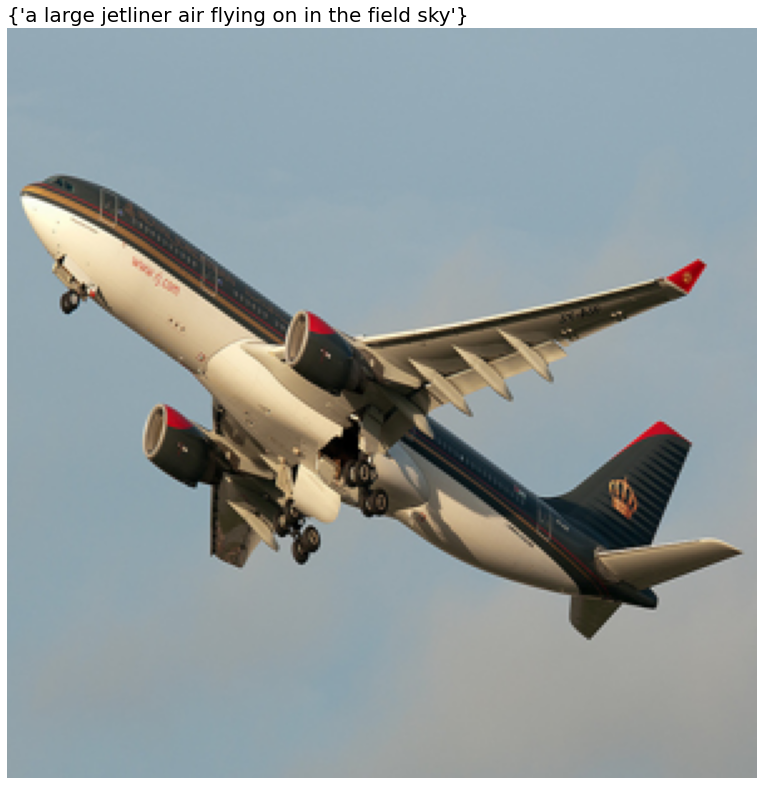

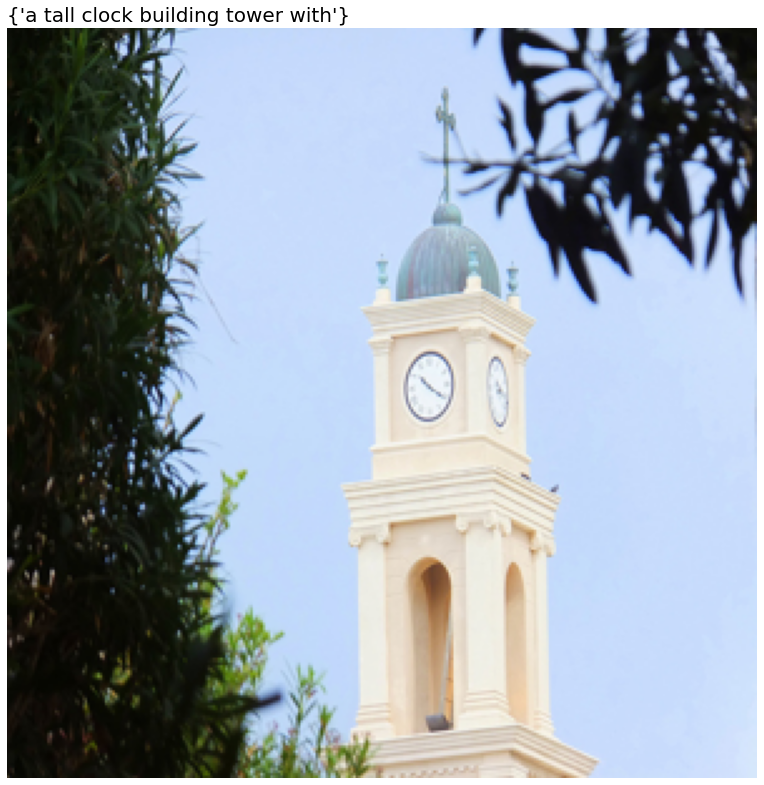

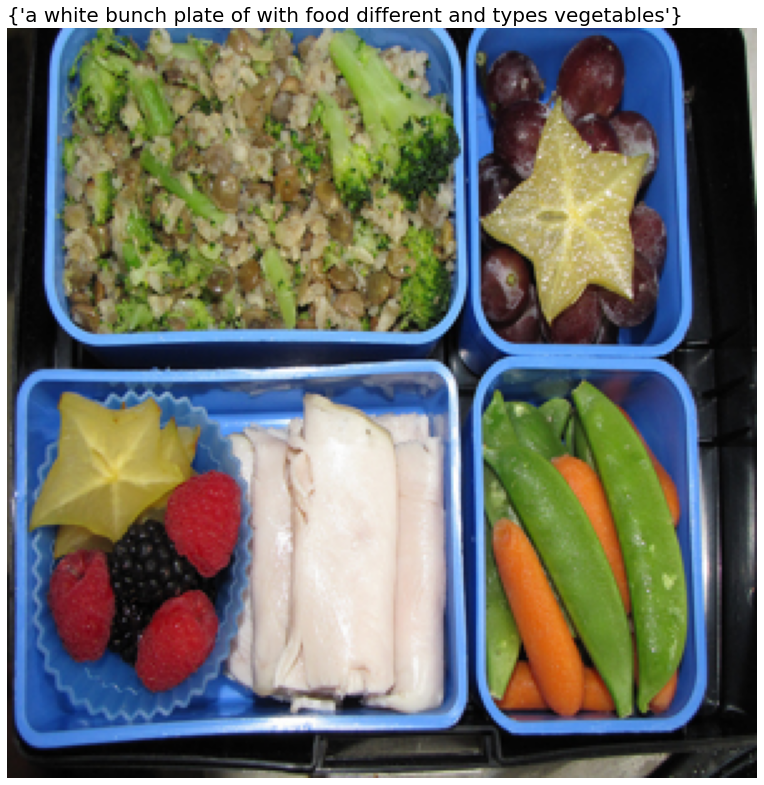

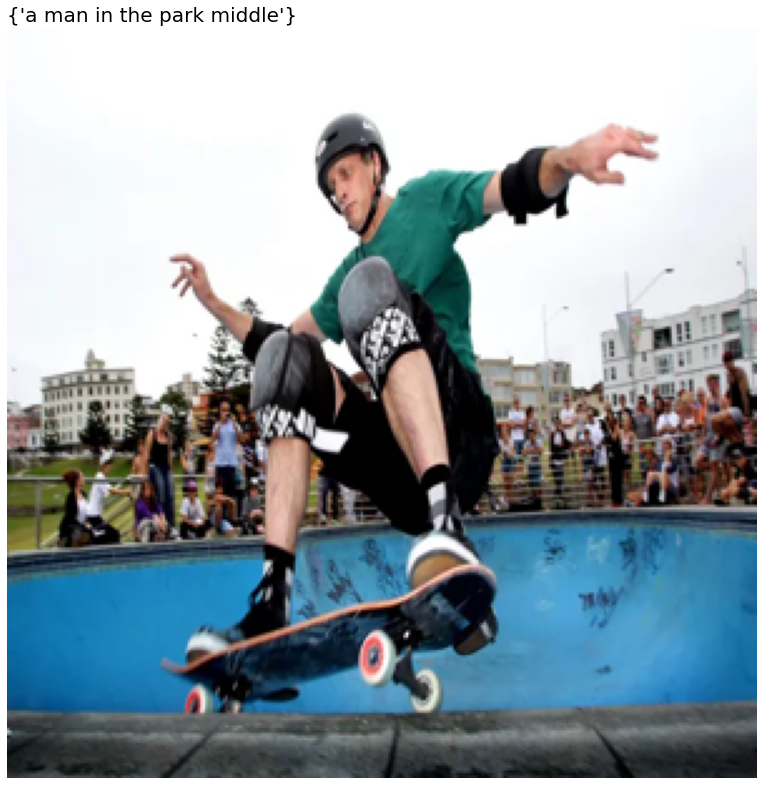

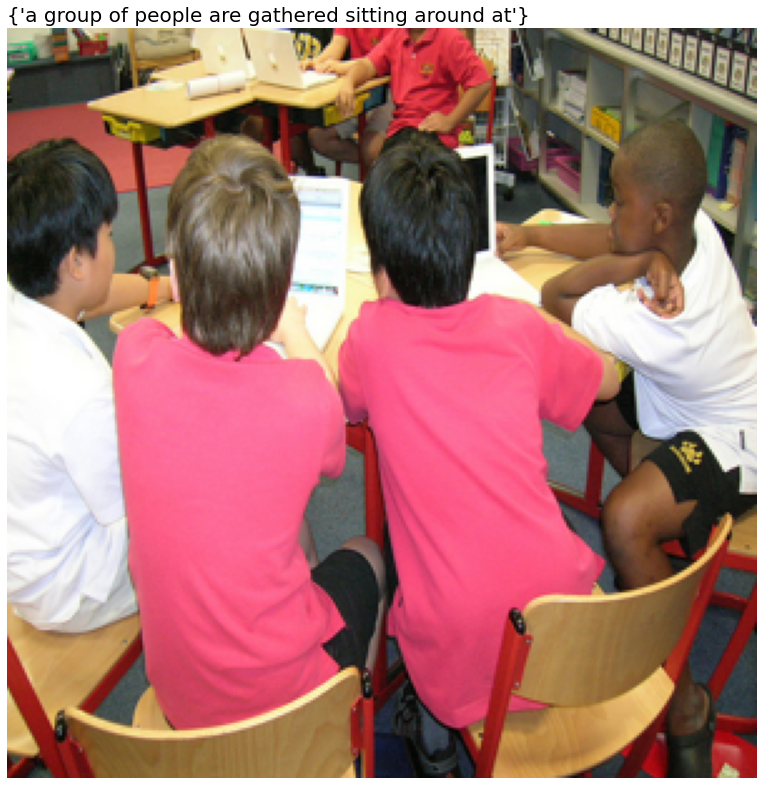

In [22]:
# Посмотрим на результат на том же фиксированном наборе изображений 
model_with_attention = False
vocab_itos = voc.vocab.itos
gen_captions = GenerateCaptions(model, vocab_itos, model_with_attention, 
                                'C:\\Users\\Ekat\\Desktop\\DataScience\\Deep_Learning\\NLP\\Final_Project\\test_images\\', 5)
gen_captions.show_imgs_and_captions()

Результат получился неоднозначный: какие-то описания (последнее, например) стали более подробными. Другие же (скейтбордист) - ухудшились по сравнению с обучением только на coco-датасете. Т.е. добавление 30000 изображений к 106 000 имеющихся существенной роли не сыграло.